# Salary Range Prediction

In [1]:
# Importing all necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score, KFold
import pickle
from flask import Flask, request, jsonify

In [2]:
Sl_rn = pd.read_csv("Jobs_NYC_Postings.csv")
Sl_rn

,Job ID,Agency,Posting Type,# Of Positions,Business Title,Civil Service Title,Title Classification,Title Code No,Level,Job Category,...,Additional Information,To Apply,Hours/Shift,Work Location 1,Recruitment Contact,Residency Requirement,Posting Date,Post Until,Posting Updated,Process Date
0,623668,DEPT OF HEALTH/MENTAL HYGIENE,External,1,"Research Analyst, IMAT, Bureau of Maternal Inf...",CITY RESEARCH SCIENTIST,Non-Competitive-5,21744,02,Constituent Services & Community Programs Heal...,...,**IMPORTANT NOTES TO ALL CANDIDATES: Please n...,Apply online with a cover letter to https://a1...,NaN,NaN,NaN,New York City residency is generally required ...,01/23/2024,22-MAY-2024,01/23/2024,03/04/2024
1,608193,DEPT OF DESIGN & CONSTRUCTION,Internal,1,Deputy Director,ADMINISTRATIVE PROJECT MANAGER,Competitive-1,8300B,00,"Policy, Research & Analysis Public Safety, Ins...",...,Authorization to work in the United States is ...,"For City Employees, please go to Employee Self...",35 Hours,"30-30 Thomson Avenue, LIC, NY 11101",NaN,New York City Residency is not required for th...,10/03/2023,NaN,11/29/2023,03/04/2024
2,625094,DEPT OF DESIGN & CONSTRUCTION,Internal,1,Senior Project Manager,ADMINISTRATIVE PROJECT MANAGER,Competitive-1,8300B,00,"Engineering, Architecture, & Planning",...,NaN,NaN,NaN,NaN,NaN,New York City Residency is not required for th...,02/01/2024,NaN,02/01/2024,03/04/2024
3,580593,DEPARTMENT OF TRANSPORTATION,External,1,Procurement Analyst 2,PROCUREMENT ANALYST,Competitive-1,12158,02,"Finance, Accounting, & Procurement",...,The City of New York is an inclusive equal opp...,Resumes may be submitted electronically using ...,9:00am â 5:00pm,To be determine.,NaN,New York City residency is generally required ...,04/04/2023,NaN,04/04/2023,03/04/2024
4,624937,DEPT OF HEALTH/MENTAL HYGIENE,External,1,"Deputy Director, HIV Planning Council, Divisio...",CITY RESEARCH SCIENTIST,Non-Competitive-5,21744,03,Constituent Services & Community Programs Heal...,...,NaN,Apply online with a cover letter to https://a1...,NaN,NaN,NaN,New York City residency is generally required ...,02/06/2024,05-JUN-2024,02/21/2024,03/04/2024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5115,570670,DEPT OF HEALTH/MENTAL HYGIENE,External,1,Public Health Nurse III / Communicable Disease...,PUBLIC HEALTH NURSE,Competitive-1,51011,03,Constituent Services & Community Programs Health,...,"**Must follow all safety, security, Blood-born...",Apply online with a cover letter to https://a1...,NaN,NaN,NaN,New York City Residency is not required for th...,01/24/2023,NaN,11/16/2023,03/04/2024
5116,552517,DEPARTMENT OF TRANSPORTATION,External,1,Engineer-In-Charge,CIVIL ENGINEER,Competitive-1,20215,02,"Engineering, Architecture, & Planning",...,The City of New York is an inclusive equal opp...,Resumes may be submitted electronically using ...,35 Hours,55 Water St Ny Ny,NaN,New York City Residency is not required for th...,09/23/2022,NaN,09/29/2022,03/04/2024
5117,567353,DEPARTMENT OF CORRECTION,External,8,"Assistant Commissioner, Facility Operations",FACILITY SUPERVISOR (CORRECTIO,Non-Competitive-5,95090,M4,"Public Safety, Inspections, & Enforcement",...,The City of New York offers a comprehensive be...,For City employees: Go to Employee Self-Servic...,NaN,NaN,NaN,New York City residency is generally required ...,01/05/2023,NaN,01/26/2023,03/04/2024
5118,612424,BRONX DISTRICT ATTORNEY,Internal,1,Human Trafficking Victim's Advocate,COMMUNITY COORDINATOR,Non-Competitive-5,56058,00,Constituent Services & Community Programs Heal...,...,NaN,"For City employees, to complete your applicati...",NaN,NaN,NaN,City Residency is not required for this position,10/20/2023,19-OCT-2024,10/20/2023,03/04/2024


# Data Preprocessing

In [3]:
# Check for missing values
missing_values = Sl_rn.isnull().sum()
print("Missing values in each column:\n", missing_values)

Missing values in each column:
 Job ID                              0
Agency                              0
Posting Type                        0
# Of Positions                      0
Business Title                      0
Civil Service Title                 0
Title Classification                0
Title Code No                       0
Level                               0
Job Category                        0
Full-Time/Part-Time indicator     117
Career Level                        0
Salary Range From                   0
Salary Range To                     0
Salary Frequency                    0
Work Location                       0
Division/Work Unit                  0
Job Description                     0
Minimum Qual Requirements          43
Preferred Skills                 1219
Additional Information           1862
To Apply                          426
Hours/Shift                      3210
Work Location 1                  3229
Recruitment Contact              5120
Residency Requirem

In [4]:
# Drop columns with too many missing values (e.g., more than 50%)
threshold = 0.5 * len(Sl_rn)
Sl_rn = Sl_rn.dropna(thresh=threshold, axis=1)

In [5]:
# After dropping high missing value columns, check remaining missing values
missing_values_after_dropping = Sl_rn.isnull().sum()
print("Missing values after dropping columns with too many missing values:\n", missing_values_after_dropping)

Missing values after dropping columns with too many missing values:
 Job ID                              0
Agency                              0
Posting Type                        0
# Of Positions                      0
Business Title                      0
Civil Service Title                 0
Title Classification                0
Title Code No                       0
Level                               0
Job Category                        0
Full-Time/Part-Time indicator     117
Career Level                        0
Salary Range From                   0
Salary Range To                     0
Salary Frequency                    0
Work Location                       0
Division/Work Unit                  0
Job Description                     0
Minimum Qual Requirements          43
Preferred Skills                 1219
Additional Information           1862
To Apply                          426
Residency Requirement               0
Posting Date                        0
Posting Updated    

In [6]:
# Fill missing values for specific columns
# Identify categorical columns
categorical_columns = ['Full-Time/Part-Time indicator', 'Work Location 1', 'Hours/Shift', 'To Apply', 'Preferred Skills', 'Additional Information', 'Minimum Qual Requirements']

# Fill missing values in categorical columns with mode
for column in categorical_columns:
    if column in Sl_rn.columns:
        Sl_rn[column].fillna(Sl_rn[column].mode()[0], inplace=True)

In [7]:
# Verify that there are no remaining missing values
missing_values_final = Sl_rn.isnull().sum()
print("Missing values after handling:\n", missing_values_final)

Missing values after handling:
 Job ID                           0
Agency                           0
Posting Type                     0
# Of Positions                   0
Business Title                   0
Civil Service Title              0
Title Classification             0
Title Code No                    0
Level                            0
Job Category                     0
Full-Time/Part-Time indicator    0
Career Level                     0
Salary Range From                0
Salary Range To                  0
Salary Frequency                 0
Work Location                    0
Division/Work Unit               0
Job Description                  0
Minimum Qual Requirements        0
Preferred Skills                 0
Additional Information           0
To Apply                         0
Residency Requirement            0
Posting Date                     0
Posting Updated                  0
Process Date                     0
dtype: int64


# Feature Selection

In [8]:
# List all column names to verify
print("Column names in the dataframe:")
print(Sl_rn.columns)

Column names in the dataframe:
Index(['Job ID', 'Agency', 'Posting Type', '# Of Positions', 'Business Title',
       'Civil Service Title', 'Title Classification', 'Title Code No', 'Level',
       'Job Category', 'Full-Time/Part-Time indicator', 'Career Level',
       'Salary Range From', 'Salary Range To', 'Salary Frequency',
       'Work Location', 'Division/Work Unit', 'Job Description',
       'Minimum Qual Requirements', 'Preferred Skills',
       'Additional Information', 'To Apply', 'Residency Requirement',
       'Posting Date', 'Posting Updated', 'Process Date'],
      dtype='object')


In [9]:
# Assuming these are the correct names from your dataset after listing the columns
relevant_features = [
    'Business Title', 
    'Civil Service Title', 
    'Title Classification', 
    'Job Category', 
    'Work Location', 
    'Residency Requirement',
    'Salary Range From',  # Including target variable for later use
    'Salary Range To'     # Including target variable for later use
]

In [10]:
# Select only the relevant features
Sl_rn_selected = Sl_rn[relevant_features]

In [11]:
# Display the first few rows of the new dataframe to verify
print(Sl_rn_selected.head())

                                      Business Title  \
0  Research Analyst, IMAT, Bureau of Maternal Inf...   
1                                    Deputy Director   
2                             Senior Project Manager   
3                              Procurement Analyst 2   
4  Deputy Director, HIV Planning Council, Divisio...   

              Civil Service Title Title Classification  \
0         CITY RESEARCH SCIENTIST    Non-Competitive-5   
1  ADMINISTRATIVE PROJECT MANAGER        Competitive-1   
2  ADMINISTRATIVE PROJECT MANAGER        Competitive-1   
3             PROCUREMENT ANALYST        Competitive-1   
4         CITY RESEARCH SCIENTIST    Non-Competitive-5   

                                        Job Category  \
0  Constituent Services & Community Programs Heal...   
1  Policy, Research & Analysis Public Safety, Ins...   
2              Engineering, Architecture, & Planning   
3                 Finance, Accounting, & Procurement   
4  Constituent Services & Communit

# Feature Engineering

In [12]:
# Extract features from 'Business Title'
Sl_rn_selected['Business_Title_Length'] = Sl_rn_selected['Business Title'].apply(len)

In [13]:
# Define a list of keywords for feature extraction
keywords = ['Manager', 'Director', 'Analyst', 'Engineer']
for keyword in keywords:
    Sl_rn_selected[f'Business_Title_Contains_{keyword}'] = Sl_rn_selected['Business Title'].apply(lambda x: 1 if keyword in x else 0)


In [14]:
# Convert categorical variables to numerical ones using One-Hot Encoding
categorical_columns = [
    'Civil Service Title', 
    'Title Classification', 
    'Job Category', 
    'Work Location', 
    'Residency Requirement'
]

In [15]:
# Perform One-Hot Encoding
Sl_rn_encoded = pd.get_dummies(Sl_rn_selected, columns=categorical_columns, drop_first=True)

In [16]:
# Calculate the target variable 'Salary Range' (mean of 'Salary Range From' and 'Salary Range To')
Sl_rn_encoded['Salary_Range_Mean'] = (Sl_rn_encoded['Salary Range From'] + Sl_rn_encoded['Salary Range To']) / 2

In [17]:
# Drop the original salary columns if not needed
Sl_rn_encoded.drop(['Salary Range From', 'Salary Range To'], axis=1, inplace=True)

# Display the first few rows of the new dataframe to verify
print(Sl_rn_encoded.head())

                                      Business Title  Business_Title_Length  \
0  Research Analyst, IMAT, Bureau of Maternal Inf...                     73   
1                                    Deputy Director                     15   
2                             Senior Project Manager                     22   
3                              Procurement Analyst 2                     21   
4  Deputy Director, HIV Planning Council, Divisio...                     81   

   Business_Title_Contains_Manager  Business_Title_Contains_Director  \
0                                0                                 0   
1                                0                                 1   
2                                1                                 0   
3                                0                                 0   
4                                0                                 1   

   Business_Title_Contains_Analyst  Business_Title_Contains_Engineer  \
0                   

#  Exploratory Data Analysis (EDA)

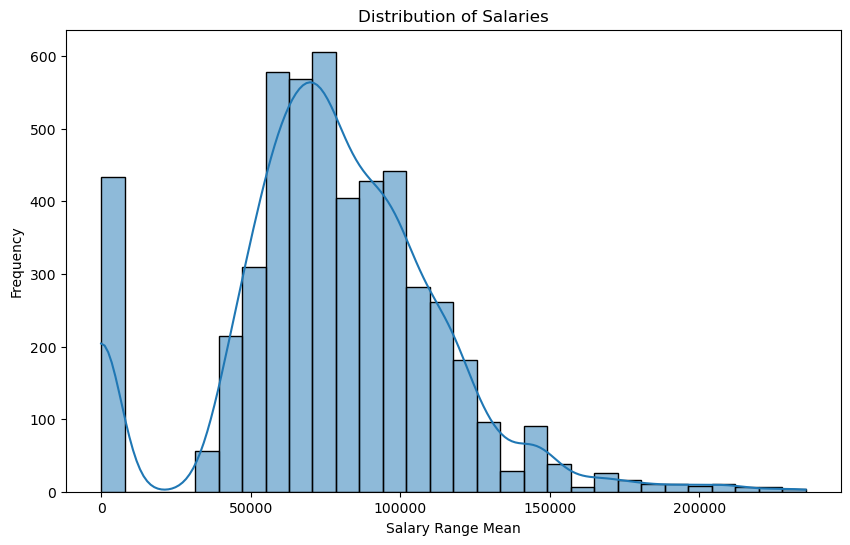

In [18]:
# Visualize the distribution of salaries
plt.figure(figsize=(10, 6))
sns.histplot(Sl_rn_encoded['Salary_Range_Mean'], bins=30, kde=True)
plt.title('Distribution of Salaries')
plt.xlabel('Salary Range Mean')
plt.ylabel('Frequency')
plt.show()

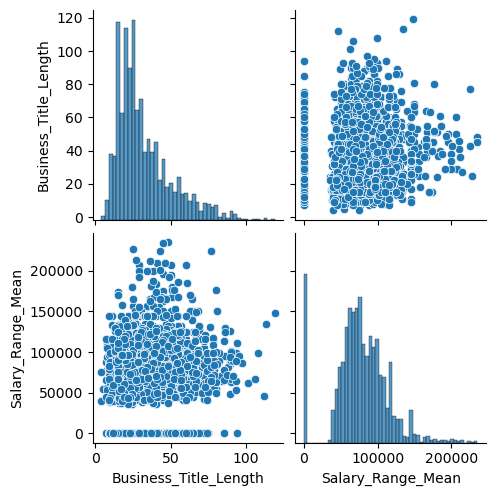

In [19]:
# Analyze relationships between different features and the target variable (salary)
# Plot pairplot for numerical features
numerical_features = ['Business_Title_Length', 'Salary_Range_Mean']
sns.pairplot(Sl_rn_encoded[numerical_features])
plt.show()

In [20]:
# Correlation Analysis
# Select only numerical columns
numerical_df = Sl_rn_selected.select_dtypes(include=['float64', 'int64'])

correlation_matrix = numerical_df.corr()

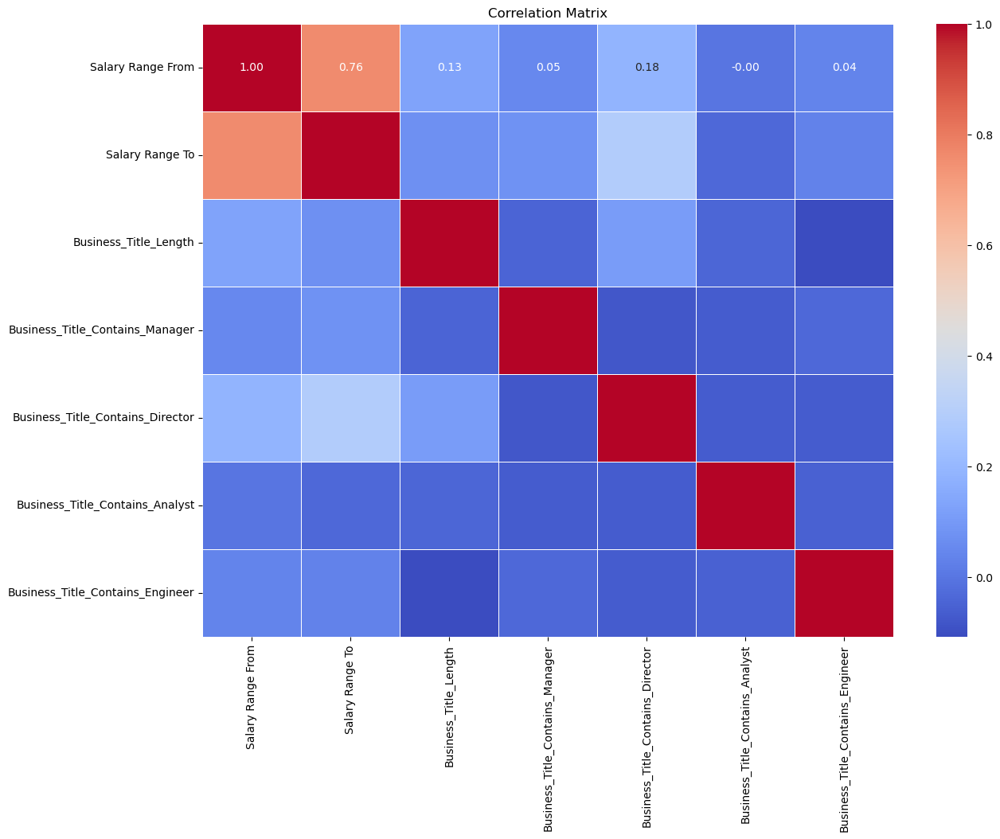

In [21]:
# Plot the heatmap
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

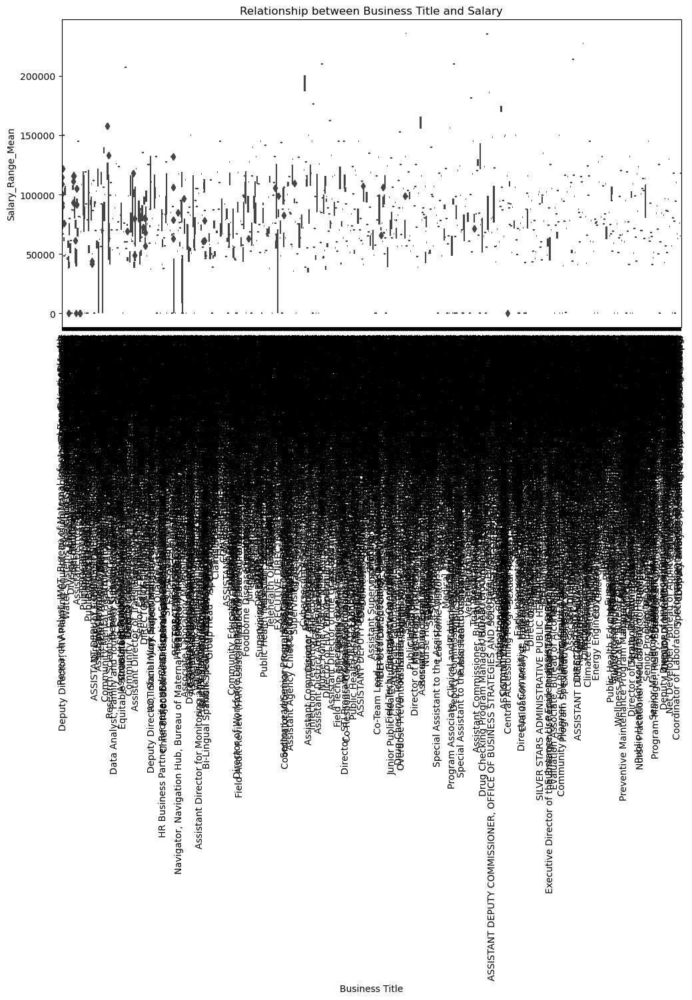

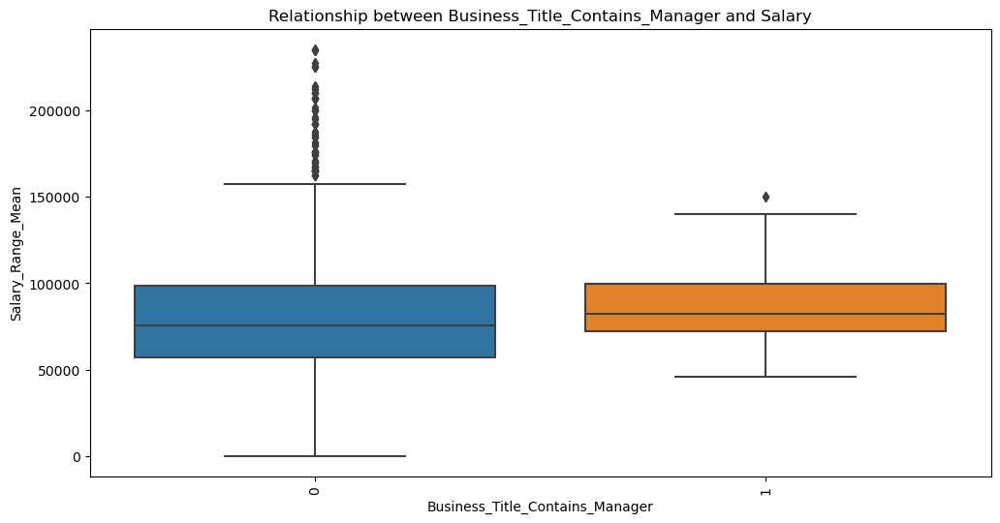

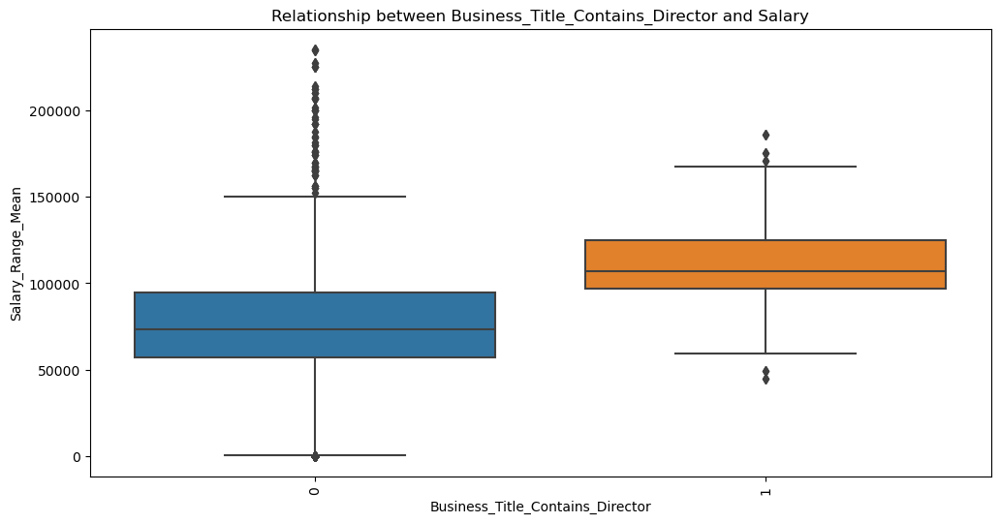

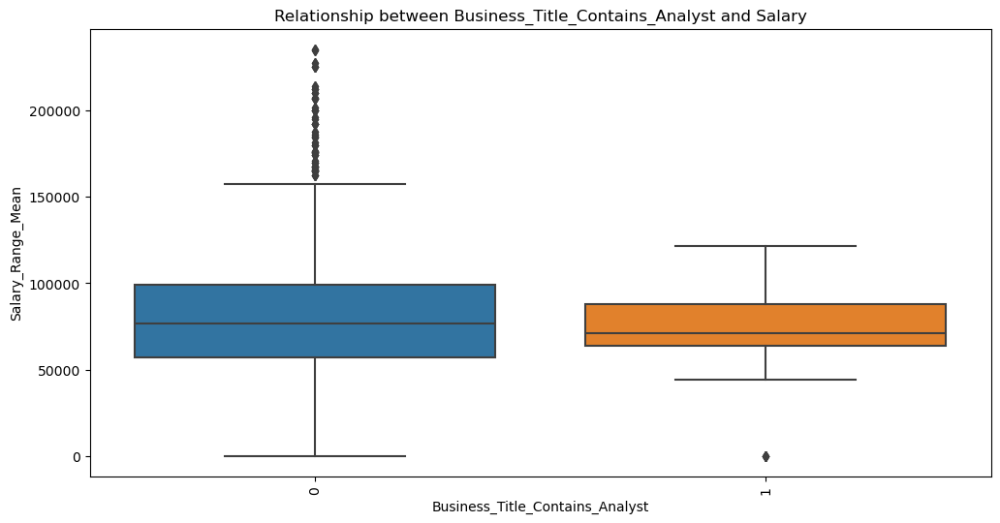

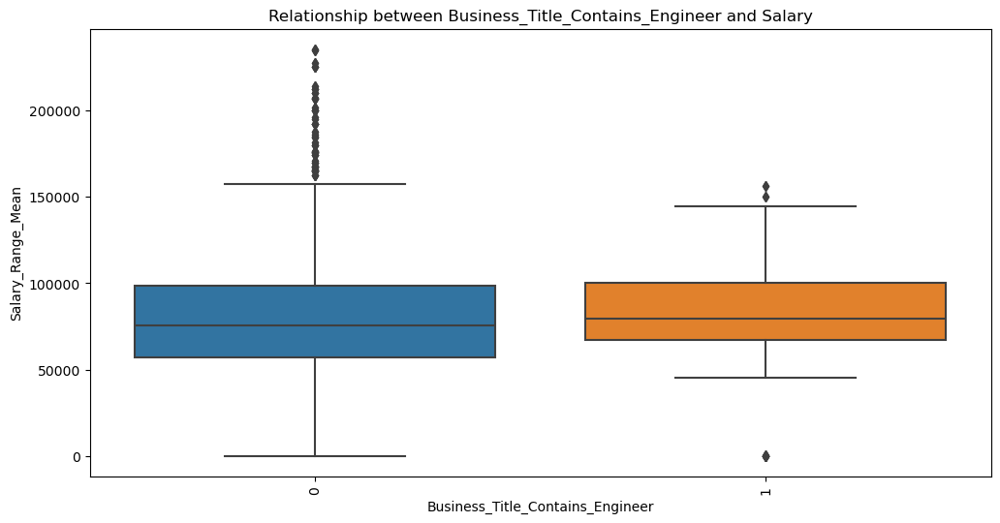

...

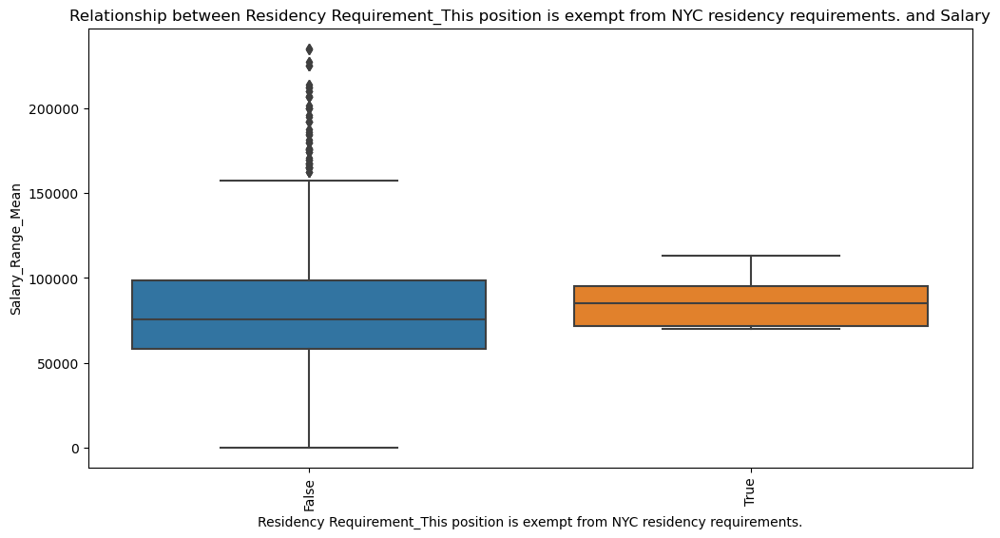

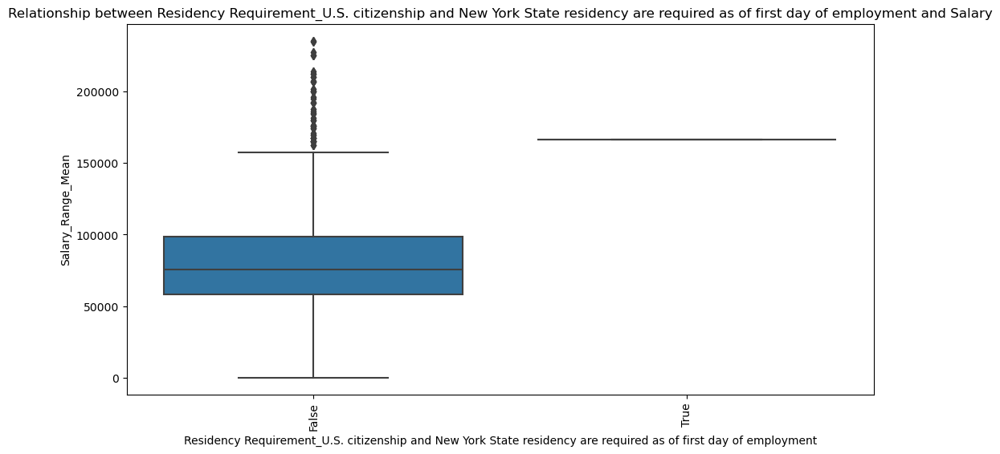

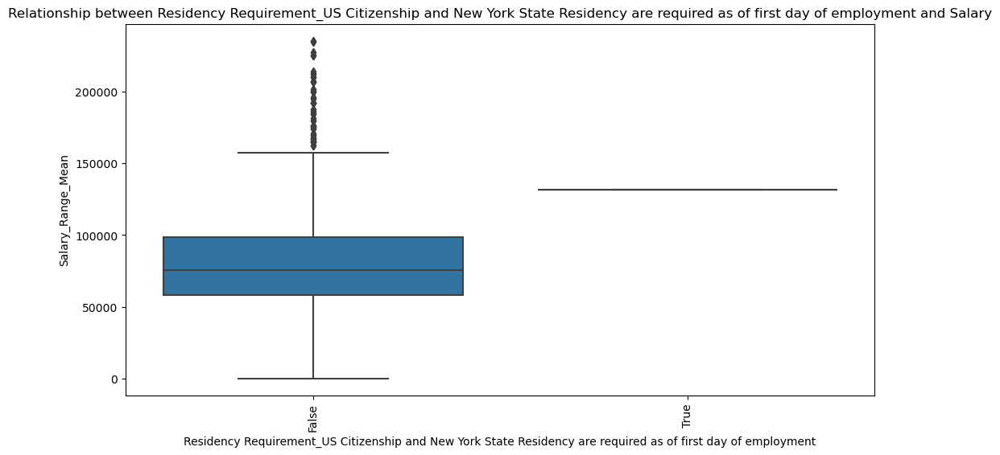

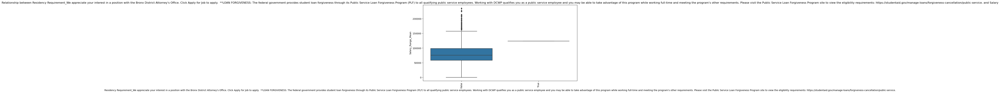

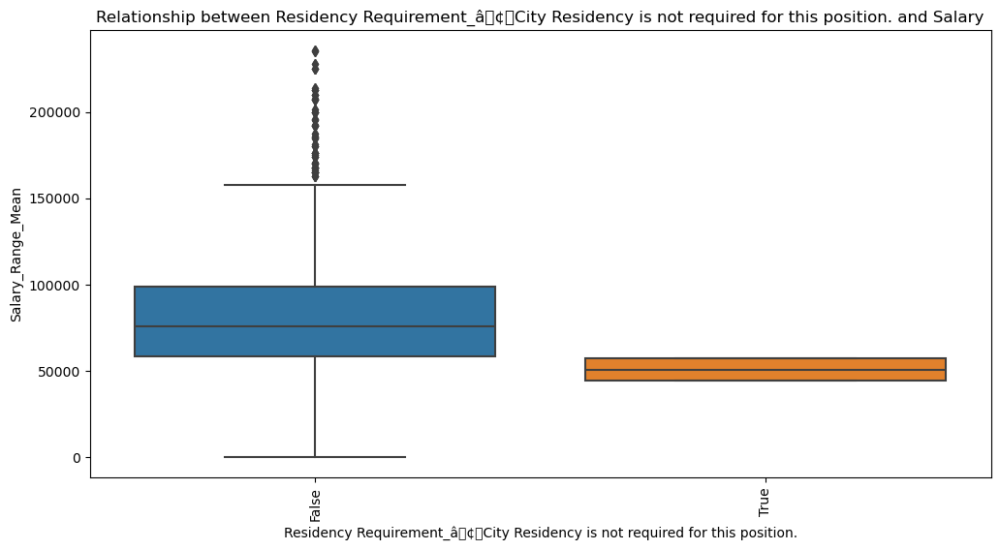

In [22]:
# Analyze relationships between categorical features and the target variable using boxplots
categorical_features = [
    col for col in Sl_rn_encoded.columns 
    if col not in numerical_features and col != 'Salary_Range_Mean'
]
for feature in categorical_features:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=feature, y='Salary_Range_Mean', data=Sl_rn_encoded)
    plt.title(f'Relationship between {feature} and Salary')
    plt.xticks(rotation=90)
    plt.show()

# Model Selection

In [23]:
# Define features and target
X = Sl_rn_selected.drop(['Salary Range From', 'Salary Range To'], axis=1)  # Features
y_from = Sl_rn_selected['Salary Range From']  # Target for "Salary Range From"
y_to = Sl_rn_selected['Salary Range To']      # Target for "Salary Range To"

In [24]:
# Convert Categorical Features to Numerical
X_encoded = pd.get_dummies(X, drop_first=True)

In [25]:
# Split the Data into Training and Testing Sets
X_train, X_test, y_train_from, y_test_from = train_test_split(X_encoded, y_from, test_size=0.2, random_state=42)
_, _, y_train_to, y_test_to = train_test_split(X_encoded, y_to, test_size=0.2, random_state=42)

In [26]:
# Define and Train Models
# Initialize models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    'Neural Network': MLPRegressor(random_state=42)
}

In [27]:
# Train and evaluate each model for 'Salary Range From'
results_from = {}
for model_name, model in models.items():
    model.fit(X_train, y_train_from)
    y_pred_from = model.predict(X_test)
    results_from[model_name] = {
        'MSE': mean_squared_error(y_test_from, y_pred_from),
        'R2': r2_score(y_test_from, y_pred_from)
    }

In [28]:
# Train and evaluate each model for 'Salary Range To'
results_to = {}
for model_name, model in models.items():
    model.fit(X_train, y_train_to)
    y_pred_to = model.predict(X_test)
    results_to[model_name] = {
        'MSE': mean_squared_error(y_test_to, y_pred_to),
        'R2': r2_score(y_test_to, y_pred_to)
    }

In [29]:
# Review the Results
print("Results for 'Salary Range From':")
for model_name, metrics in results_from.items():
    print(f"{model_name}: MSE = {metrics['MSE']}, R2 = {metrics['R2']}")

Results for 'Salary Range From':
Linear Regression: MSE = 6.929710257857253e+25, R2 = -7.387282217209206e+16
Decision Tree: MSE = 71159705.33763802, R2 = 0.9241415865509612
Random Forest: MSE = 107105768.28453746, R2 = 0.8858219885150656
Gradient Boosting: MSE = 449591851.9204513, R2 = 0.5207213910670665
Neural Network: MSE = 1684170156.6243525, R2 = -0.7953766876008697


In [30]:
print("\nResults for 'Salary Range To':")
for model_name, metrics in results_to.items():
    print(f"{model_name}: MSE = {metrics['MSE']}, R2 = {metrics['R2']}")


Results for 'Salary Range To':
Linear Regression: MSE = 8.613202728900864e+24, R2 = -3964033177641488.5
Decision Tree: MSE = 111470639.99260144, R2 = 0.9486981406137192
Random Forest: MSE = 170708822.36008292, R2 = 0.9214350971583564
Gradient Boosting: MSE = 923585355.1554503, R2 = 0.5749405760605844
Neural Network: MSE = 4481564380.506444, R2 = -1.0625393887983967


# Hyperparameter Tuning

# Grid Search

In [31]:
# Define Models and Hyperparameter Grids
models = {
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(random_state=42),
    'Neural Network': MLPRegressor(random_state=42)
}

param_grids = {
    'Decision Tree': {
        'max_depth': [5, 10, 20],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4]
    },
    'Random Forest': {
        'n_estimators': [50, 100, 200],
        'max_depth': [5, 10, 20],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4]
    },
    'Gradient Boosting': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7]
    },
    'Neural Network': {
        'hidden_layer_sizes': [(50,), (100,), (50,50)],
        'activation': ['relu', 'tanh'],
        'solver': ['adam', 'sgd'],
        'alpha': [0.0001, 0.001, 0.01]
    }
}

In [32]:
results_from = {}
results_to = {}

for model_name, model in models.items():
    print(f"Training {model_name}...")

    grid_search_from = GridSearchCV(estimator=model, param_grid=param_grids[model_name], cv=5, scoring='r2', n_jobs=-1)
    grid_search_from.fit(X_train, y_train_from)
    
    best_model_from = grid_search_from.best_estimator_
    y_pred_from = best_model_from.predict(X_test)
    
    results_from[model_name] = {
        'Best Parameters': grid_search_from.best_params_,
        'MSE': mean_squared_error(y_test_from, y_pred_from),
        'R2': r2_score(y_test_from, y_pred_from)
    }
    
    grid_search_to = GridSearchCV(estimator=model, param_grid=param_grids[model_name], cv=5, scoring='r2', n_jobs=-1)
    grid_search_to.fit(X_train, y_train_to)
    
    best_model_to = grid_search_to.best_estimator_
    y_pred_to = best_model_to.predict(X_test)
    
    results_to[model_name] = {
        'Best Parameters': grid_search_to.best_params_,
        'MSE': mean_squared_error(y_test_to, y_pred_to),
        'R2': r2_score(y_test_to, y_pred_to)
    }

print("Results for 'Salary Range From':")
for model_name, metrics in results_from.items():
    print(f"{model_name}: Best Parameters = {metrics['Best Parameters']}, MSE = {metrics['MSE']}, R2 = {metrics['R2']}")

print("\nResults for 'Salary Range To':")
for model_name, metrics in results_to.items():
    print(f"{model_name}: Best Parameters = {metrics['Best Parameters']}, MSE = {metrics['MSE']}, R2 = {metrics['R2']}")

Training Decision Tree...
Training Random Forest...
Training Gradient Boosting...
Training Neural Network...
Results for 'Salary Range From':
Decision Tree: Best Parameters = {'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2}, MSE = 321434294.9106227, R2 = 0.6573412505808498
Random Forest: Best Parameters = {'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}, MSE = 323083493.2410485, R2 = 0.6555831549252353
Gradient Boosting: Best Parameters = {'learning_rate': 0.2, 'max_depth': 7, 'n_estimators': 200}, MSE = 102781863.2378443, R2 = 0.890431403003084
Neural Network: Best Parameters = {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (50, 50), 'solver': 'adam'}, MSE = 471532683.88433003, R2 = 0.49733179586519505

Results for 'Salary Range To':
Decision Tree: Best Parameters = {'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2}, MSE = 632118289.6024423, R2 = 0.7090817491418977
Random Forest: Best Parameters = {'max_d

# Models Evaluation

In [33]:
# Function to evaluate the model
def evaluate_model(model, X_test, y_test):
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    return mse, mae, r2

In [34]:
# Evaluate each model for 'Salary Range From'
print("Evaluating models for 'Salary Range From'...")

for model_name, metrics in results_from.items():
    best_model_from = GridSearchCV(estimator=models[model_name], param_grid=param_grids[model_name], cv=5, scoring='r2', n_jobs=-1)
    best_model_from.fit(X_train, y_train_from)
    mse, mae, r2 = evaluate_model(best_model_from.best_estimator_, X_test, y_test_from)
    print(f"{model_name}: MSE = {mse}, MAE = {mae}, R2 = {r2}")

Evaluating models for 'Salary Range From'...
Decision Tree: MSE = 321434294.9106227, MAE = 10940.005544985506, R2 = 0.6573412505808498
Random Forest: MSE = 323083493.2410485, MAE = 11420.77728006025, R2 = 0.6555831549252353
Gradient Boosting: MSE = 102781863.2378443, MAE = 6854.647574353265, R2 = 0.890431403003084
Neural Network: MSE = 471532683.88433003, MAE = 13420.41531243822, R2 = 0.49733179586519505


In [35]:
# Evaluate each model for 'Salary Range To'
print("\nEvaluating models for 'Salary Range To'...")

for model_name, metrics in results_to.items():
    best_model_to = GridSearchCV(estimator=models[model_name], param_grid=param_grids[model_name], cv=5, scoring='r2', n_jobs=-1)
    best_model_to.fit(X_train, y_train_to)
    mse, mae, r2 = evaluate_model(best_model_to.best_estimator_, X_test, y_test_to)
    print(f"{model_name}: MSE = {mse}, MAE = {mae}, R2 = {r2}")


Evaluating models for 'Salary Range To'...
Decision Tree: MSE = 632118289.6024423, MAE = 15444.038084328091, R2 = 0.7090817491418977
Random Forest: MSE = 601784388.0426204, MAE = 16522.01892729616, R2 = 0.7230422462966871
Gradient Boosting: MSE = 197815041.44449443, MAE = 10491.528189984441, R2 = 0.908960068396931
Neural Network: MSE = 870463921.5539832, MAE = 20813.143460405598, R2 = 0.5993885232258739


In [36]:
# Define a function to perform cross-validation and print results
def cross_validate_model(model, X, y, cv=5):
    cv_scores = cross_val_score(model, X, y, cv=cv, scoring='r2')
    print(f"Cross-Validation R2 Scores = {cv_scores}, Mean R2 = {cv_scores.mean()}")
    return cv_scores

# Cross-validate each model for 'Salary Range From'
print("Cross-Validation for 'Salary Range From':")
for model_name, model in models.items():
    print(f"\n{model_name}:")
    best_model_from = GridSearchCV(estimator=model, param_grid=param_grids[model_name], cv=5, scoring='r2', n_jobs=-1)
    best_model_from.fit(X_train, y_train_from)
    cross_validate_model(best_model_from.best_estimator_, X_train, y_train_from)

Cross-Validation for 'Salary Range From':

Decision Tree:
Cross-Validation R2 Scores = [0.58996485 0.61009247 0.6062279  0.60884705 0.53919701], Mean R2 = 0.5908658534337652

Random Forest:
Cross-Validation R2 Scores = [0.65324633 0.67015836 0.58535684 0.65034511 0.60015834], Mean R2 = 0.631852994047975

Gradient Boosting:
Cross-Validation R2 Scores = [0.82973059 0.85863587 0.80437181 0.85503195 0.77664208], Mean R2 = 0.8248824590023519

Neural Network:
Cross-Validation R2 Scores = [0.37701187 0.4089826  0.39853276 0.35569754 0.41173276], Mean R2 = 0.3903915052256658


In [37]:
# Cross-validate each model for 'Salary Range To'
print("\nCross-Validation for 'Salary Range To':")
for model_name, model in models.items():
    print(f"\n{model_name}:")
    best_model_to = GridSearchCV(estimator=model, param_grid=param_grids[model_name], cv=5, scoring='r2', n_jobs=-1)
    best_model_to.fit(X_train, y_train_to)
    cross_validate_model(best_model_to.best_estimator_, X_train, y_train_to)


Cross-Validation for 'Salary Range To':

Decision Tree:
Cross-Validation R2 Scores = [0.61811935 0.64639493 0.67544273 0.68945286 0.65145455], Mean R2 = 0.6561728836499906

Random Forest:
Cross-Validation R2 Scores = [0.67794037 0.70833751 0.70992874 0.71300931 0.69799432], Mean R2 = 0.7014420498979063

Gradient Boosting:
Cross-Validation R2 Scores = [0.84160824 0.87685812 0.8842377  0.85584052 0.85819199], Mean R2 = 0.8633473156030049

Neural Network:
Cross-Validation R2 Scores = [0.40205975 0.41293577 0.43126708 0.39521474 0.42745558], Mean R2 = 0.4137865828960545


# Deployment

In [56]:
gb_best_model = best_model_to
# Assuming gb_best_model is the best Gradient Boosting model after tuning
best_model = gb_best_model

# Save the model using pickle
with open('best_salary_model.pkl', 'wb') as file:
    pickle.dump(best_model, file)

print("Model saved as 'best_salary_model.pkl'.")

Model saved as 'best_salary_model.pkl'.


In [57]:
# Load the model
with open('best_salary_model.pkl', 'rb') as file:
    model = pickle.load(file)

# Initialize the Flask app
app = Flask(__name__)

# Define a route for prediction
@app.route('/predict', methods=['POST'])
def predict():
    data = request.json  # Get the JSON data
    input_features = np.array(data['features']).reshape(1, -1)  # Convert to a numpy array and reshape for prediction
    
    # Perform the prediction
    prediction = model.predict(input_features)
    
    # Return the prediction as JSON
    return jsonify({'prediction': prediction[0]})

# Run the Flask app
if __name__ == '__main__':
    app.run(debug=True)

 * Serving Flask app '__main__'
 * Debug mode: on


 * Running on http://127.0.0.1:5000
Press CTRL+C to quit
 * Restarting with watchdog (windowsapi)


SystemExit: 1

In [58]:
if __name__ == "__main__":
    app.run(debug=True)

 * Serving Flask app '__main__'
 * Debug mode: on


 * Running on http://127.0.0.1:5000
Press CTRL+C to quit
 * Restarting with watchdog (windowsapi)


SystemExit: 1

In [59]:
# This file lists all the dependencies your project needs.
!pip freeze > requirements.txt

In [60]:
# Committing code to a Git repository:
!git init
!git add .
!git commit -m "Initial commit"

'git' is not recognized as an internal or external command,
operable program or batch file.
'git' is not recognized as an internal or external command,
operable program or batch file.
'git' is not recognized as an internal or external command,
operable program or batch file.


In [61]:
# Deploy to Heroku:
!heroku create
!git push heroku master
!heroku ps:scale web=1
!heroku open

'heroku' is not recognized as an internal or external command,
operable program or batch file.
'git' is not recognized as an internal or external command,
operable program or batch file.
'heroku' is not recognized as an internal or external command,
operable program or batch file.
'heroku' is not recognized as an internal or external command,
operable program or batch file.


This will deploy your Flask API to Heroku, where it can be accessed via the provided URL. The API will accept POST requests with JSON data containing the features for prediction and return the predicted salary.

# Conclusion 

Given these cross-validation results, the Gradient Boosting model is the most robust and likely to perform best on unseen data. It consistently outperforms the other models in both the initial evaluation and cross-validation.